# Синтез изображений. Часть 2. Генеративно-Состязательная Сеть (GAN)

## Переключение версии TensorFlow

In [1]:
%tensorflow_version 2.x

In [2]:
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
import tensorflow_datasets as tfds

## Загрузка и подготовка датасета LFW

In [3]:
train_ds, info_ds = tfds.load(
    'lfw',
    split='train',
    as_supervised=False,
    with_info = True
)

In [4]:
def prepare(item):
  image = item['image']
  image = (tf.cast(image, tf.float32) - 127.5) / 127.5
  image = tf.image.resize(image,[56,56])
  return image


train_ds = train_ds.map(prepare)
train_ds

<DatasetV1Adapter shapes: (56, 56, 3), types: tf.float32>

## Визуализация датасета LFW

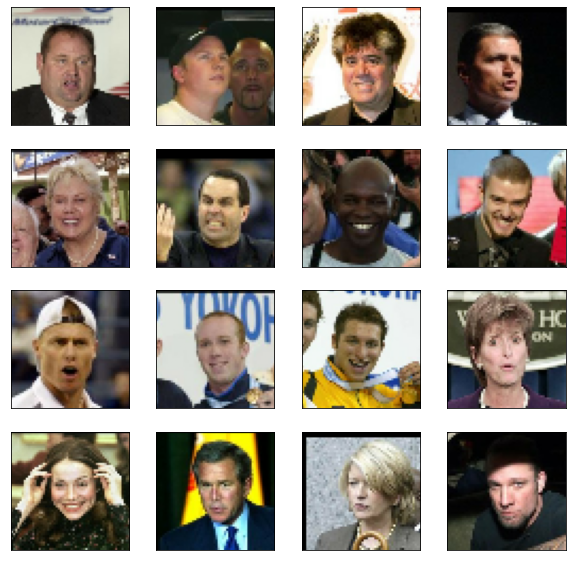

In [5]:
def plot_digits(data):
    fig = plt.figure(figsize=(10, 10))
    for i, img in enumerate(data.take(16)):
        ax = fig.add_subplot(4, 4, i+1)
        ax.imshow((img+1)/2)
        plt.xticks([]), plt.yticks([])
    plt.show()
    
plot_digits(train_ds)

## Deep Convolutional GAN (DCGAN)

In [6]:
generator = tf.keras.Sequential([
    tf.keras.layers.Dense(256*7*7, activation='relu'),
    tf.keras.layers.Reshape((7, 7, 256)),

    tf.keras.layers.UpSampling2D((2, 2)),    
    tf.keras.layers.Conv2D(256, (3, 3), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(),  

    tf.keras.layers.UpSampling2D((2, 2)),    
    tf.keras.layers.Conv2D(128, (3, 3), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(),       

    tf.keras.layers.UpSampling2D((2, 2)),    
    tf.keras.layers.Conv2D(64, (3, 3), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(), 

    tf.keras.layers.Conv2D(3, (3, 3), padding='same', activation='tanh'),
])

discriminator = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), strides=(2, 2), padding='same'),
    tf.keras.layers.LeakyReLU(0.2),
    tf.keras.layers.Dropout(0.25),    
    tf.keras.layers.Conv2D(64, kernel_size=3, strides=(2, 2), padding='same'),
    tf.keras.layers.ZeroPadding2D(padding=((0, 1), (0, 1))),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Conv2D(128, kernel_size=3, strides=(2, 2), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Conv2D(256, kernel_size=3, strides=(1, 1), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(1),
])

In [7]:
INPUT_DIM = 300
NUM_EPOCHS = 20
HALF_BATCH_SIZE = 16
BATCH_SIZE = HALF_BATCH_SIZE * 2
LEARNING_RATE = 0.0002

train_ds = train_ds.shuffle(info_ds.splits.total_num_examples)
train_ds = train_ds.repeat(NUM_EPOCHS)
train_ds = train_ds.batch(HALF_BATCH_SIZE, drop_remainder=True)

optimizer = tf.keras.optimizers.Adam(LEARNING_RATE)
sigmoid_cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [8]:
def plot_syntetic(samples):
    fig = plt.figure(figsize=(10, 10))
    num = samples.shape[0]
    for j in range(num):
        ax = fig.add_subplot(4, 4, j+1)
        ax.imshow((samples[j, ...].reshape(56, 56, 3)+1)/2)
        plt.xticks([]), plt.yticks([])
    plt.show()

[Step  0] D Loss: 0.6625; G Loss: 0.6459


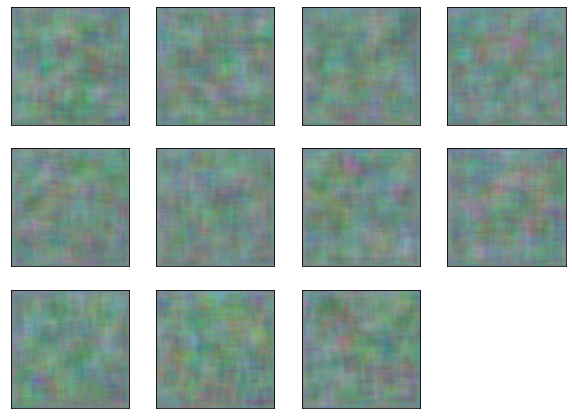

[Step 200] D Loss: 0.1548; G Loss: 1.7438


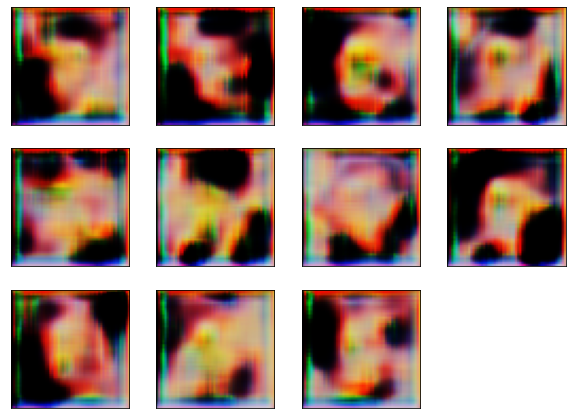

[Step 400] D Loss: 0.0089; G Loss: 0.7265


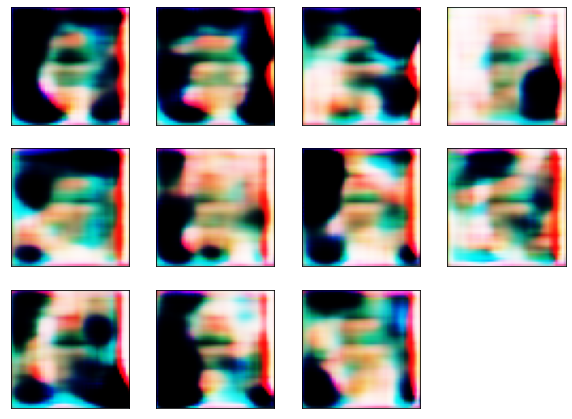

[Step 600] D Loss: 0.2099; G Loss: 0.6782


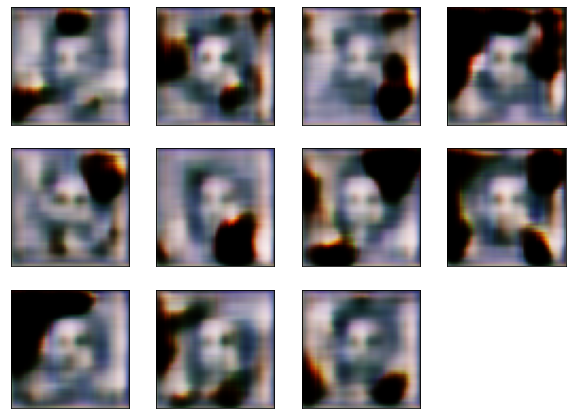

[Step 800] D Loss: 0.3219; G Loss: 2.8003


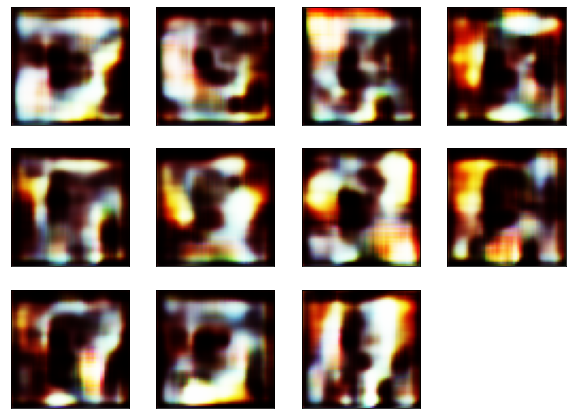

[Step 1000] D Loss: 0.2834; G Loss: 6.2747


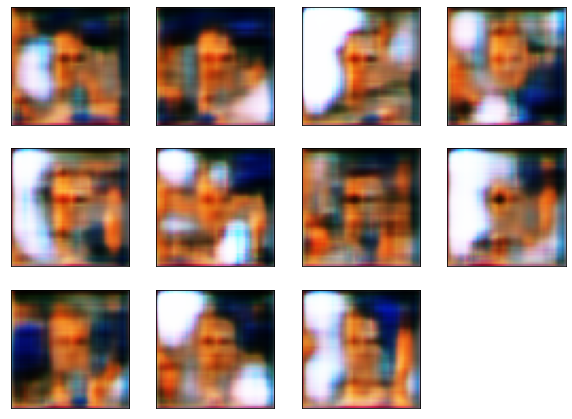

[Step 1200] D Loss: 0.5182; G Loss: 4.3577


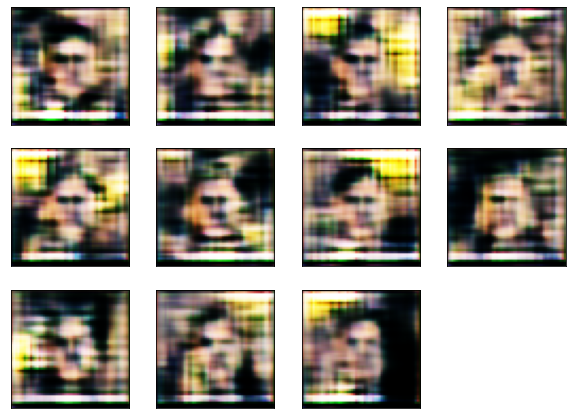

[Step 1400] D Loss: 0.2585; G Loss: 2.8845


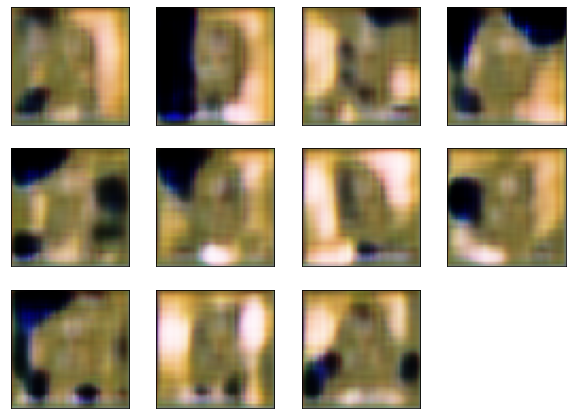

[Step 1600] D Loss: 0.5388; G Loss: 5.2787


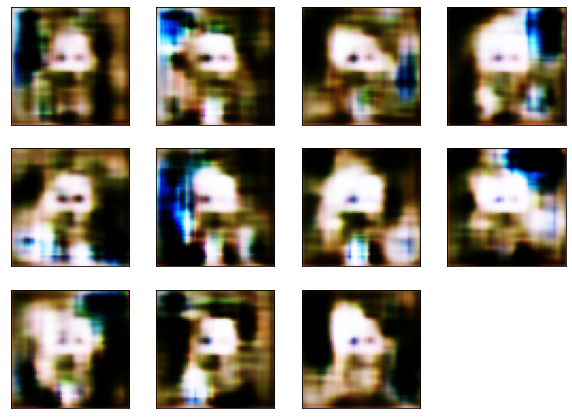

[Step 1800] D Loss: 0.2626; G Loss: 3.0640


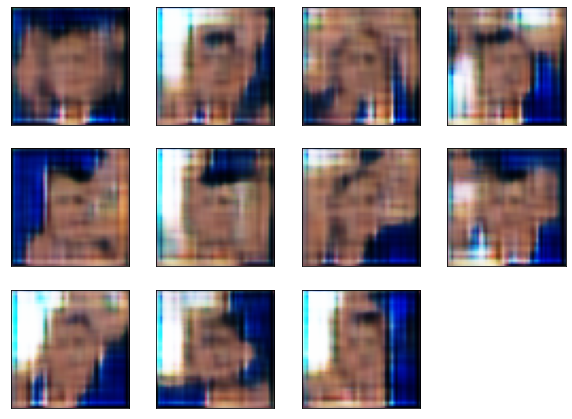

[Step 2000] D Loss: 0.4623; G Loss: 2.9278


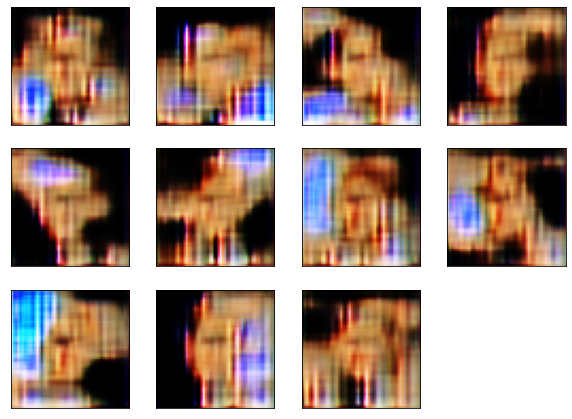

[Step 2200] D Loss: 0.3007; G Loss: 2.8791


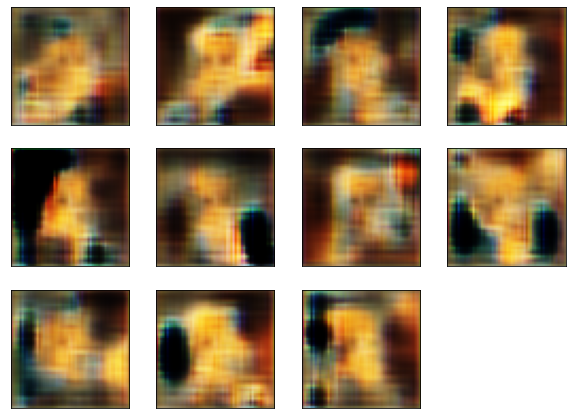

[Step 2400] D Loss: 0.6848; G Loss: 0.1775


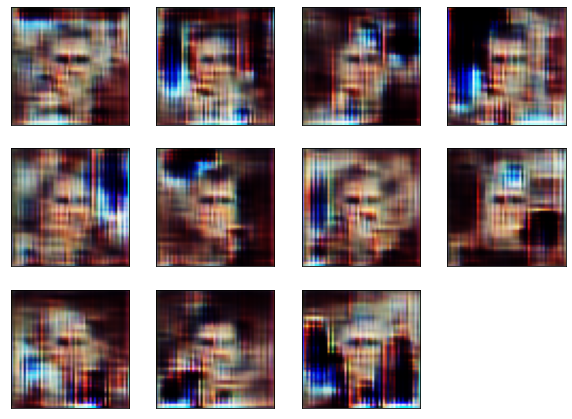

[Step 2600] D Loss: 0.1979; G Loss: 1.7451


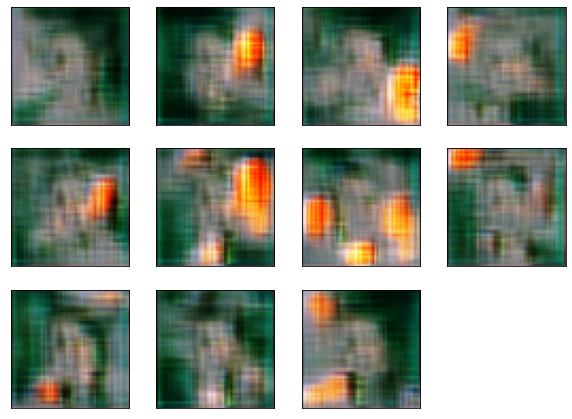

[Step 2800] D Loss: 0.1304; G Loss: 6.6984


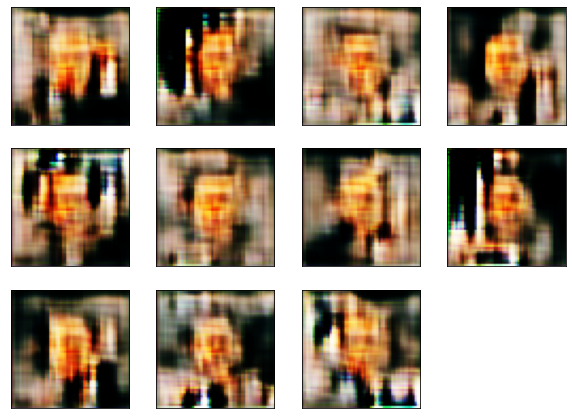

[Step 3000] D Loss: 0.2313; G Loss: 6.8570


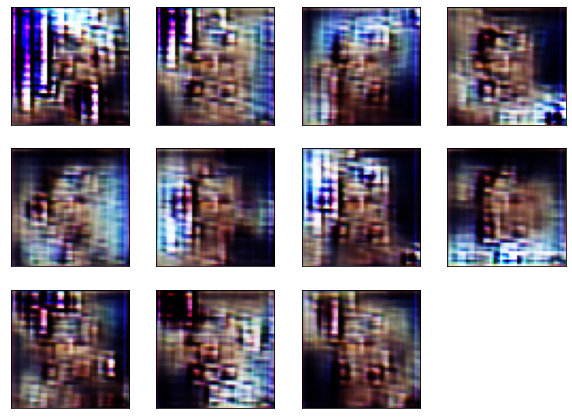

[Step 3200] D Loss: 0.0763; G Loss: 6.9376


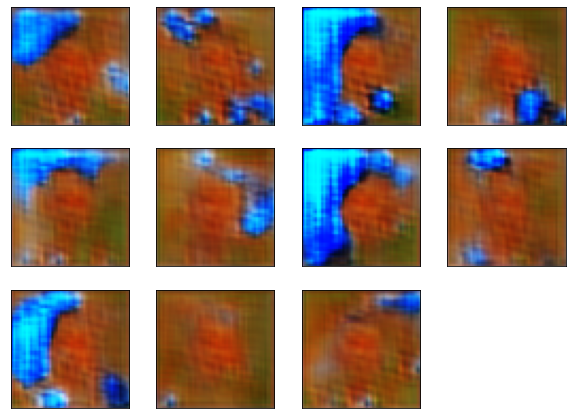

[Step 3400] D Loss: 0.0564; G Loss: 4.6215


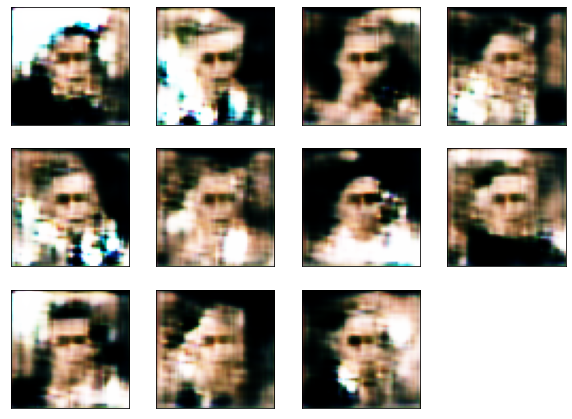

[Step 3600] D Loss: 0.8169; G Loss: 2.7728


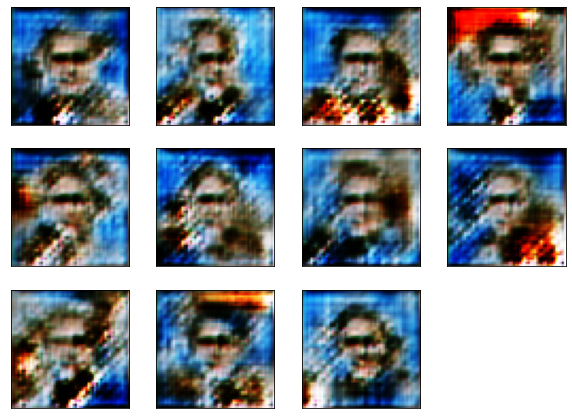

[Step 3800] D Loss: 0.1964; G Loss: 6.1082


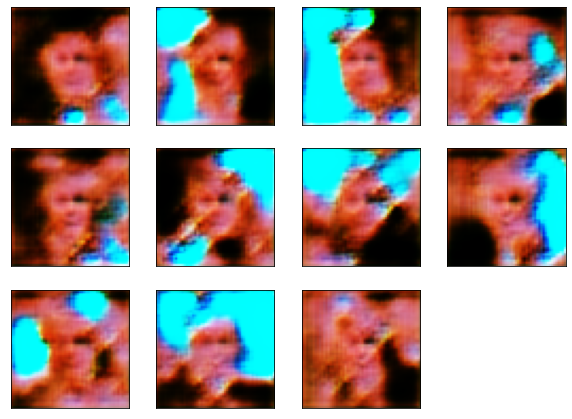

[Step 4000] D Loss: 1.0621; G Loss: 0.3129


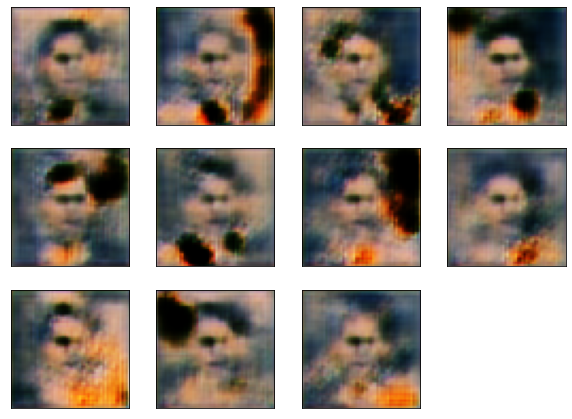

[Step 4200] D Loss: 0.3522; G Loss: 0.6776


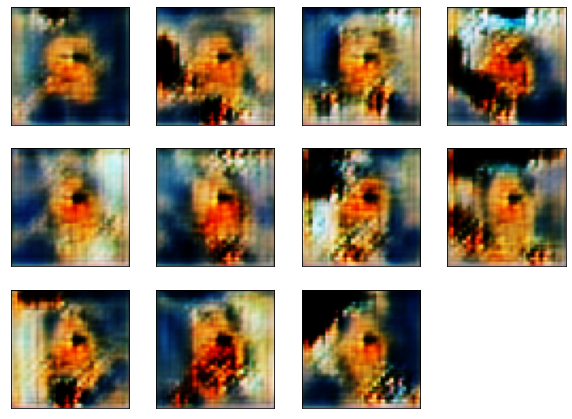

[Step 4400] D Loss: 0.1305; G Loss: 2.8389


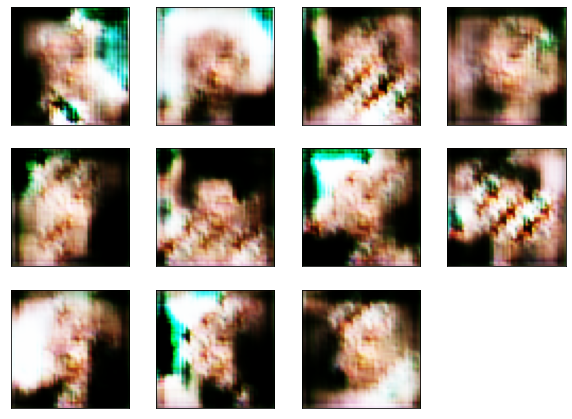

[Step 4600] D Loss: 0.1475; G Loss: 4.0546


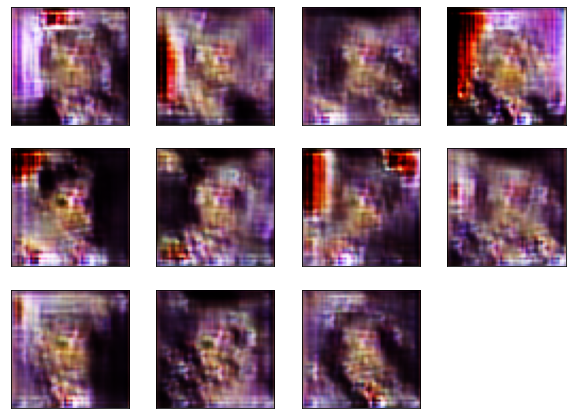

[Step 4800] D Loss: 0.2042; G Loss: 3.5097


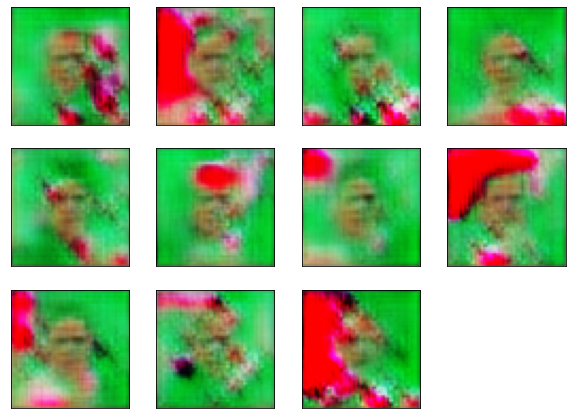

[Step 5000] D Loss: 0.6670; G Loss: 2.0375


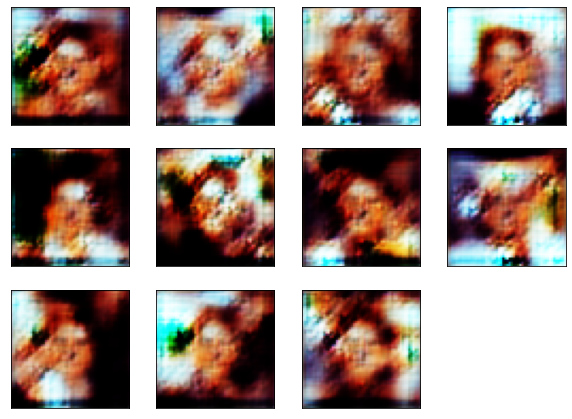

[Step 5200] D Loss: 0.7976; G Loss: 2.1403


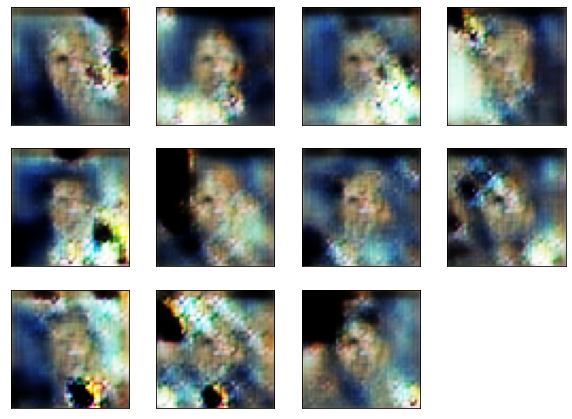

[Step 5400] D Loss: 0.6185; G Loss: 7.2523


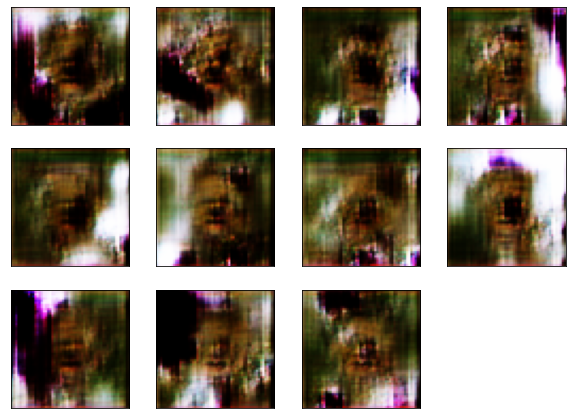

[Step 5600] D Loss: 0.6243; G Loss: 5.5557


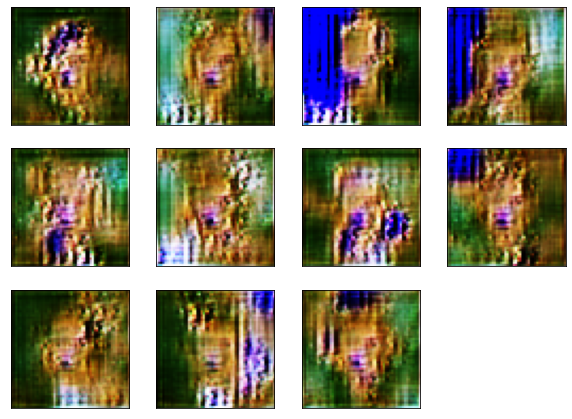

[Step 5800] D Loss: 0.5055; G Loss: 6.1163


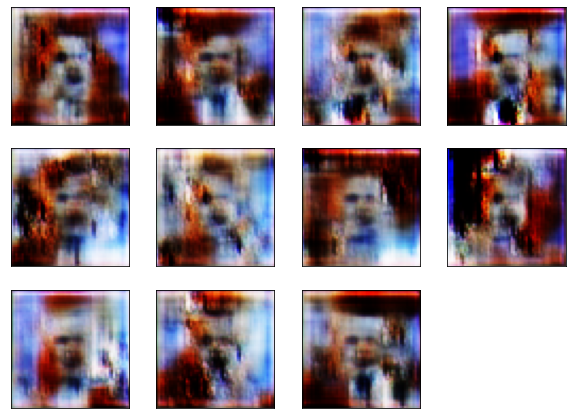

[Step 6000] D Loss: 0.3901; G Loss: 5.3816


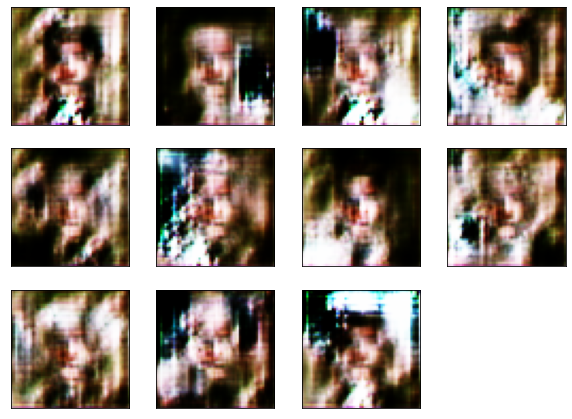

[Step 6200] D Loss: 0.1129; G Loss: 5.0699


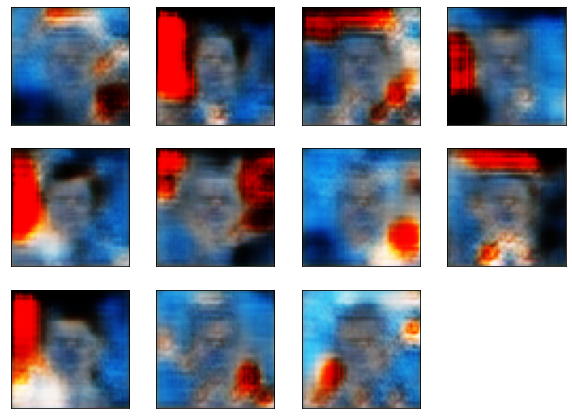

[Step 6400] D Loss: 0.4163; G Loss: 3.7506


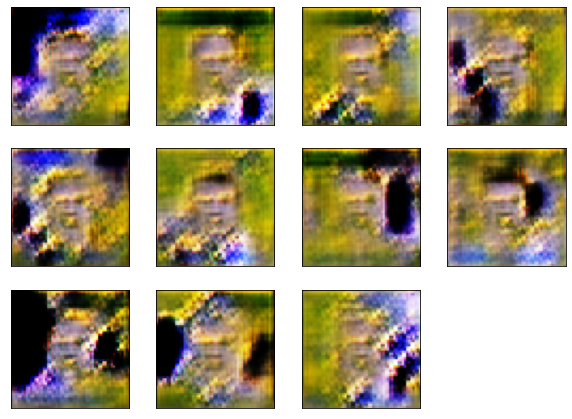

[Step 6600] D Loss: 0.6730; G Loss: 5.5312


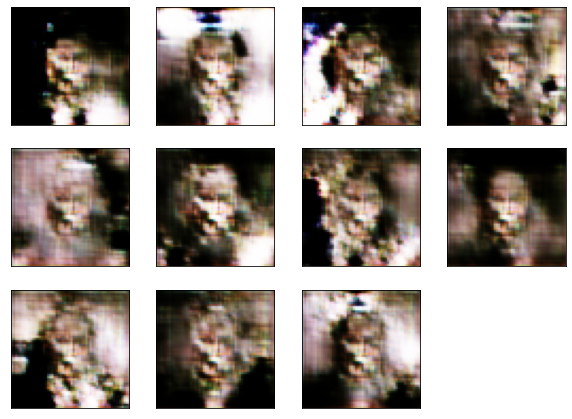

[Step 6800] D Loss: 0.0945; G Loss: 6.2780


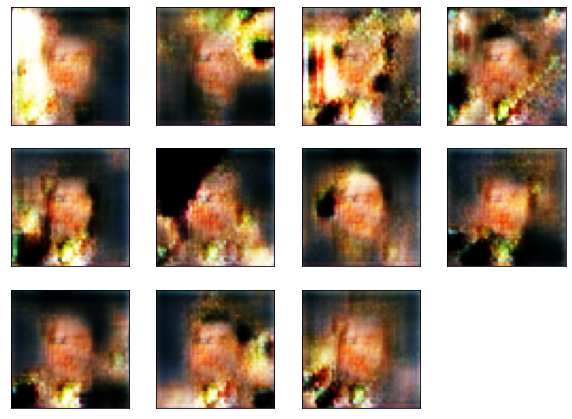

[Step 7000] D Loss: 0.3348; G Loss: 6.1768


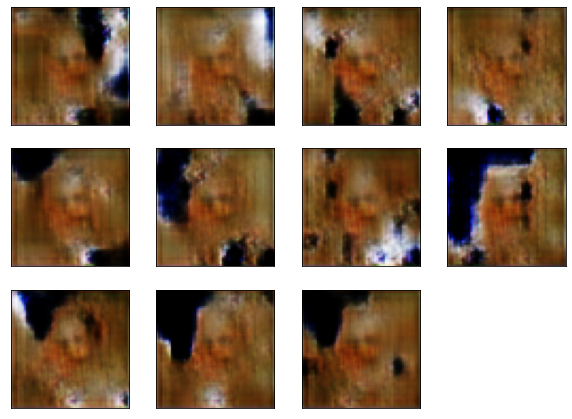

[Step 7200] D Loss: 0.4054; G Loss: 5.5379


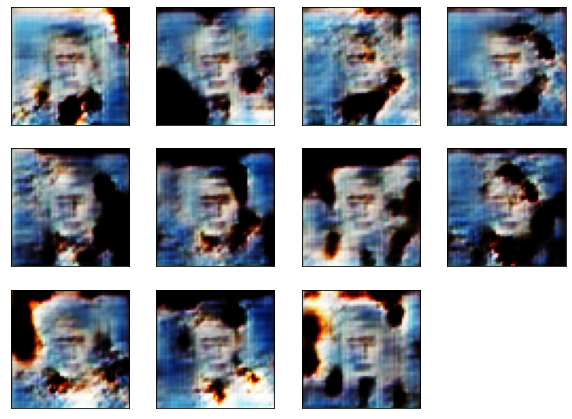

[Step 7400] D Loss: 0.3174; G Loss: 3.3300


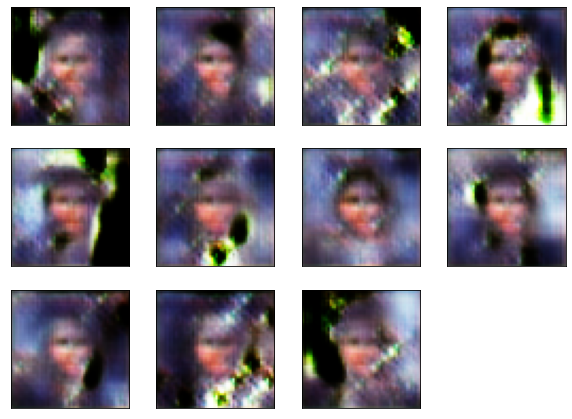

[Step 7600] D Loss: 0.3058; G Loss: 5.3861


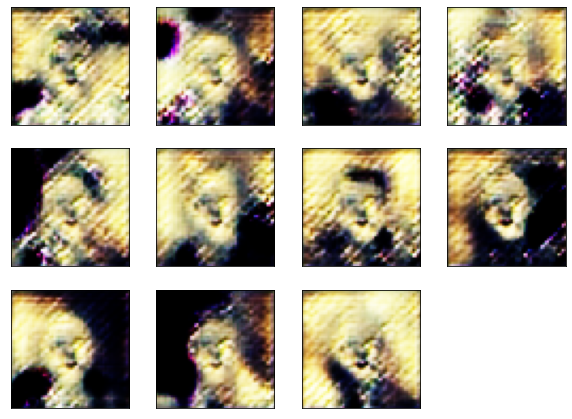

[Step 7800] D Loss: 0.1705; G Loss: 3.7593


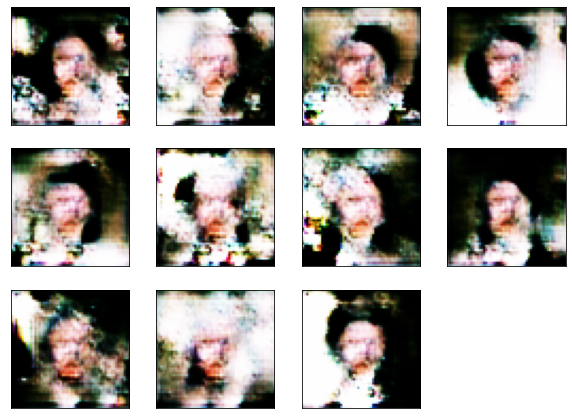

[Step 8000] D Loss: 0.2820; G Loss: 3.3387


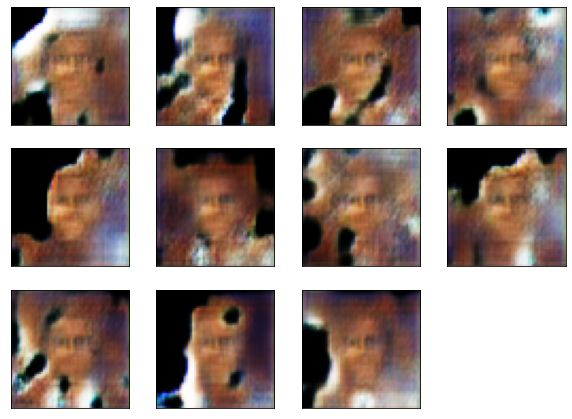

[Step 8200] D Loss: 0.2741; G Loss: 6.4373


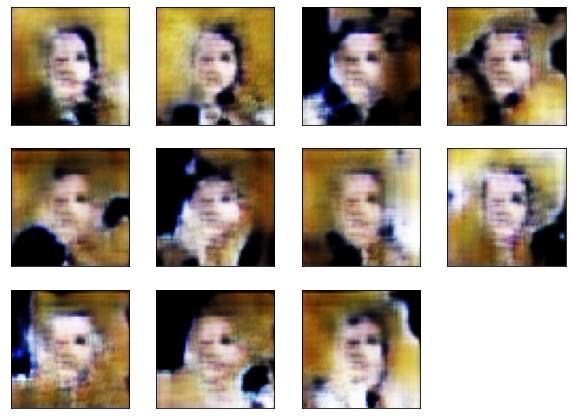

[Step 8400] D Loss: 0.2287; G Loss: 6.6434


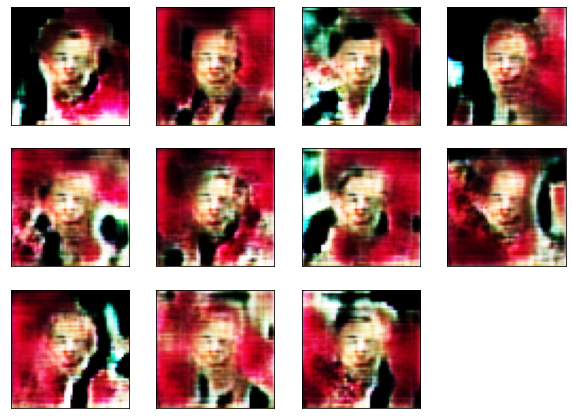

[Step 8600] D Loss: 0.0442; G Loss: 5.3185


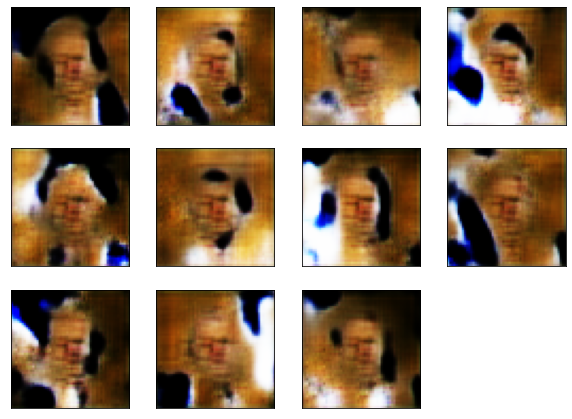

[Step 8800] D Loss: 0.0318; G Loss: 5.7921


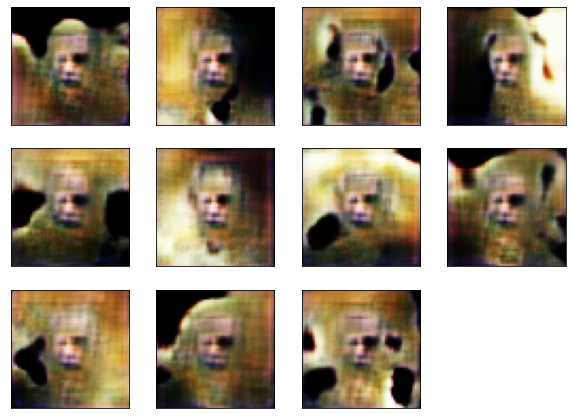

[Step 9000] D Loss: 0.3021; G Loss: 5.2987


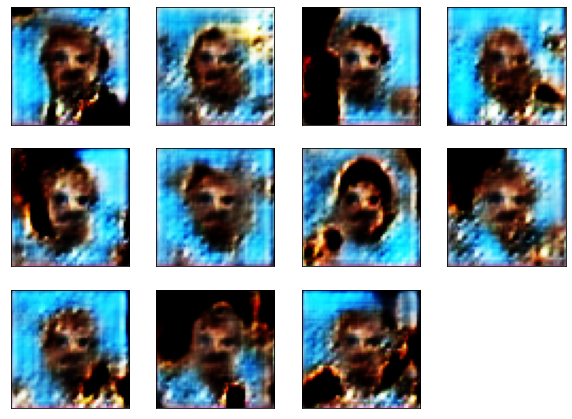

[Step 9200] D Loss: 0.1015; G Loss: 3.2295


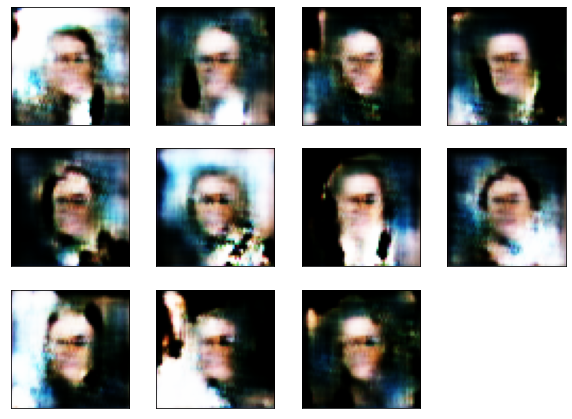

[Step 9400] D Loss: 0.1991; G Loss: 3.3916


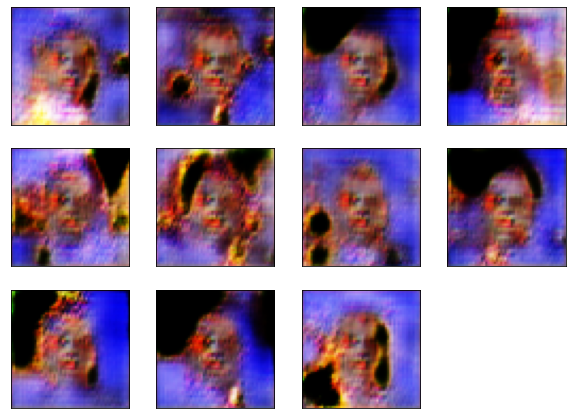

[Step 9600] D Loss: 0.6483; G Loss: 4.9597


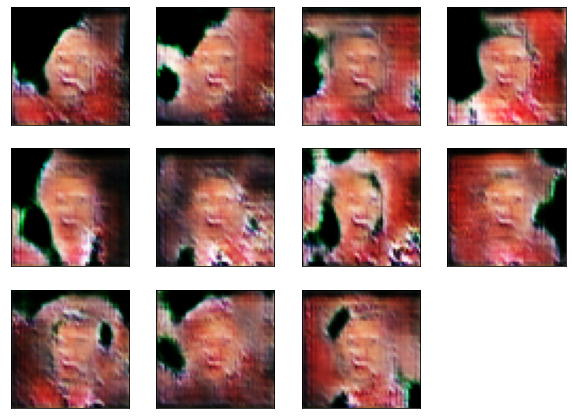

[Step 9800] D Loss: 0.3441; G Loss: 4.9999


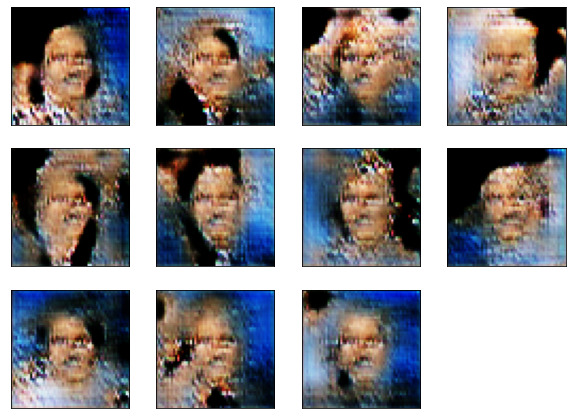

[Step 10000] D Loss: 0.6770; G Loss: 3.5626


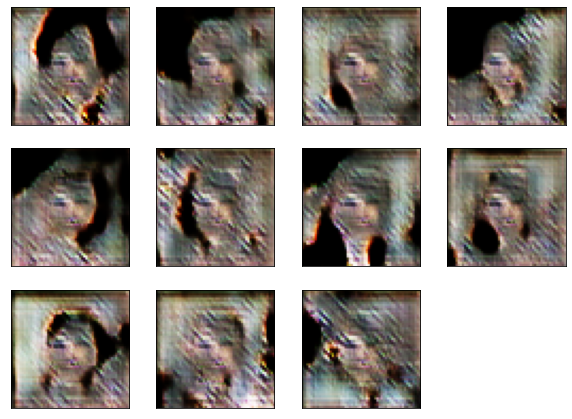

[Step 10200] D Loss: 0.3352; G Loss: 5.1174


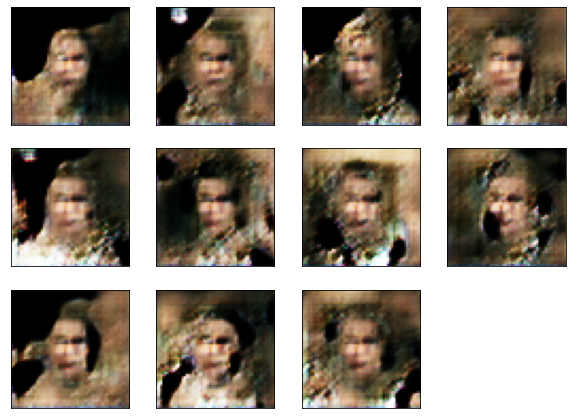

[Step 10400] D Loss: 0.0891; G Loss: 6.5752


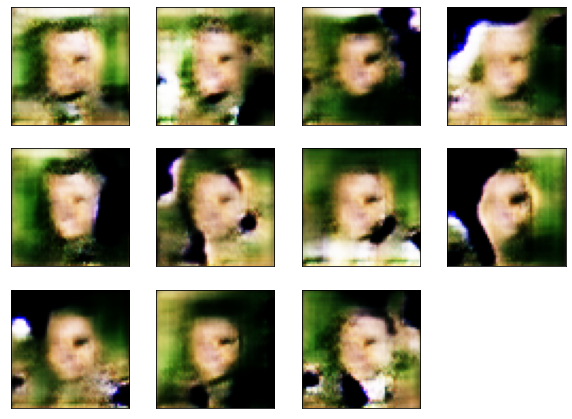

[Step 10600] D Loss: 0.0617; G Loss: 5.4842


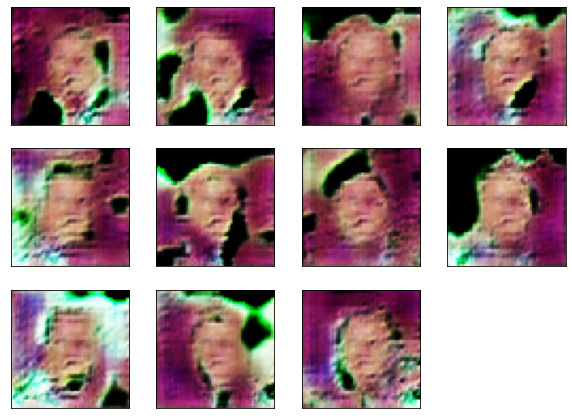

[Step 10800] D Loss: 0.0267; G Loss: 6.8084


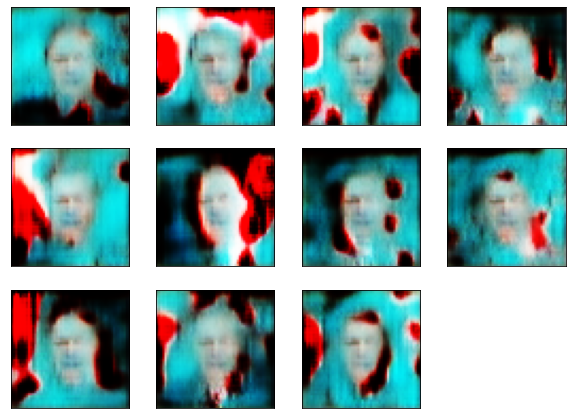

[Step 11000] D Loss: 0.2054; G Loss: 8.0256


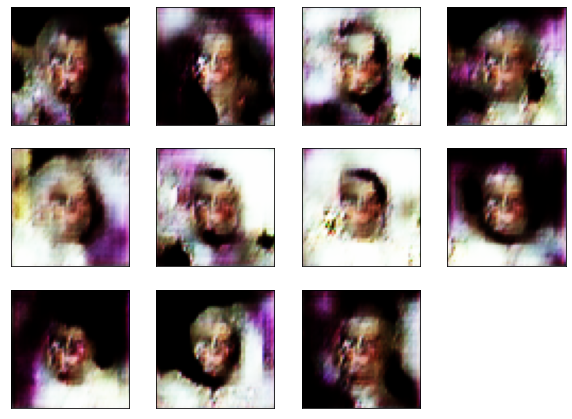

[Step 11200] D Loss: 0.3584; G Loss: 4.8260


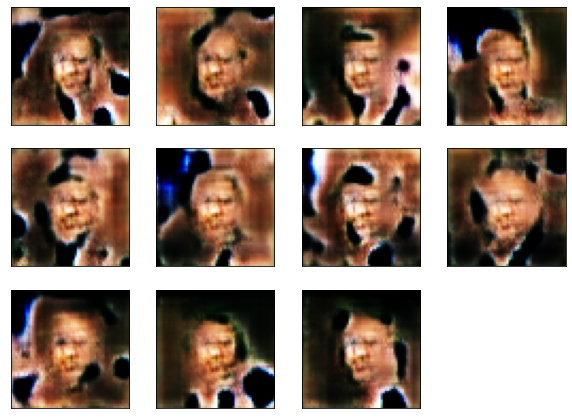

[Step 11400] D Loss: 0.4977; G Loss: 7.4417


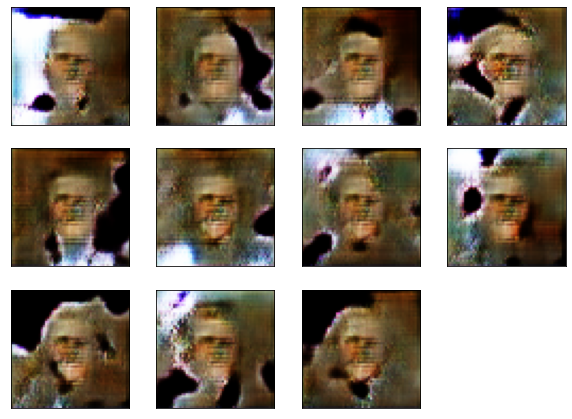

[Step 11600] D Loss: 0.5623; G Loss: 3.9850


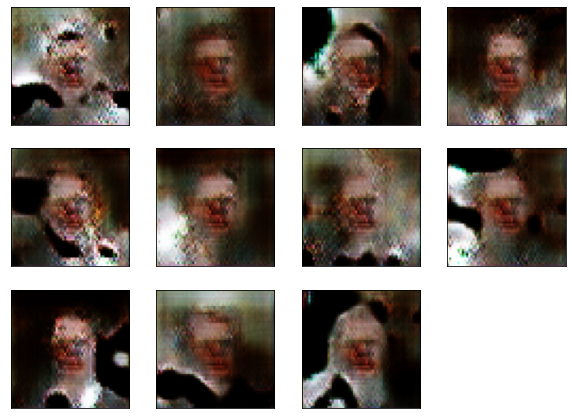

[Step 11800] D Loss: 0.9742; G Loss: 9.1585


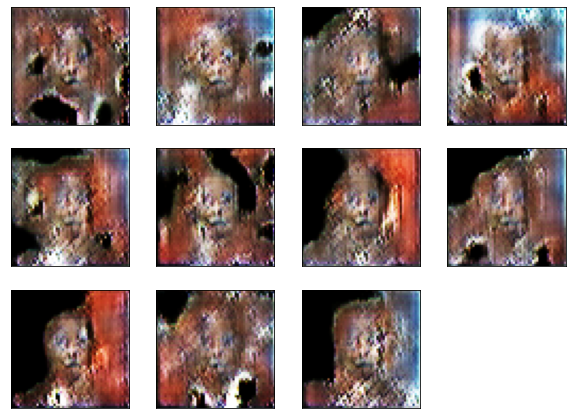

[Step 12000] D Loss: 0.1285; G Loss: 5.5576


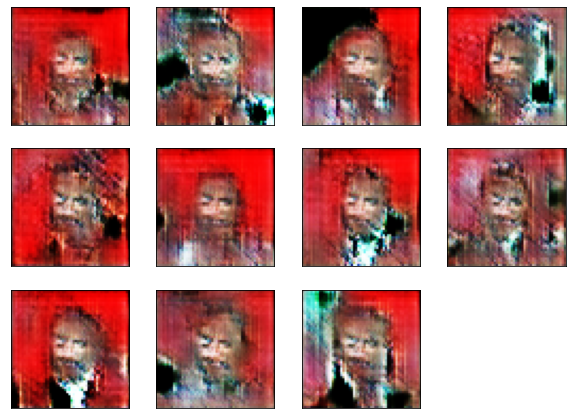

[Step 12200] D Loss: 0.3280; G Loss: 6.8237


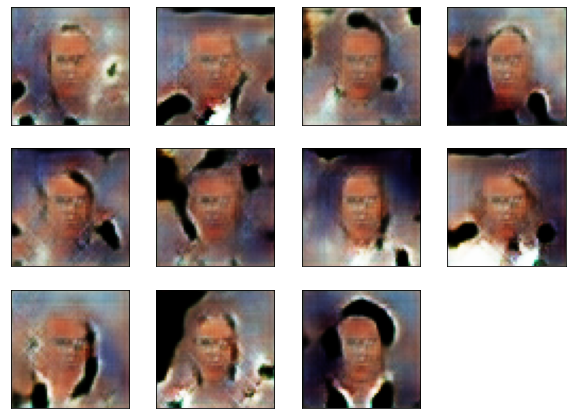

[Step 12400] D Loss: 0.2874; G Loss: 4.2809


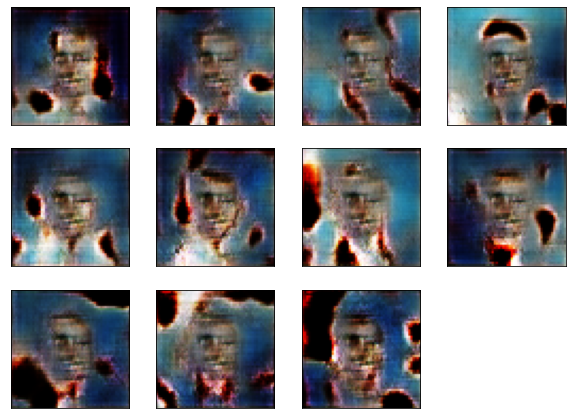

[Step 12600] D Loss: 0.3267; G Loss: 9.3778


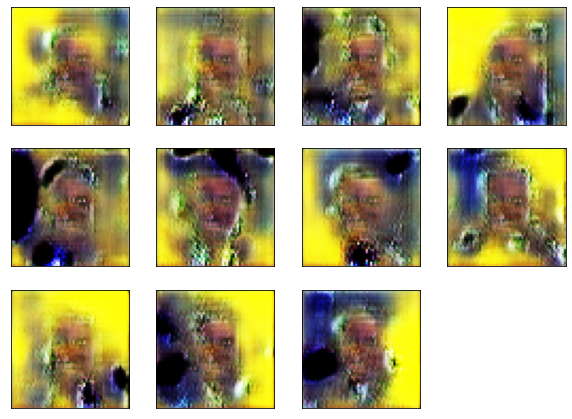

[Step 12800] D Loss: 0.0842; G Loss: 6.9266


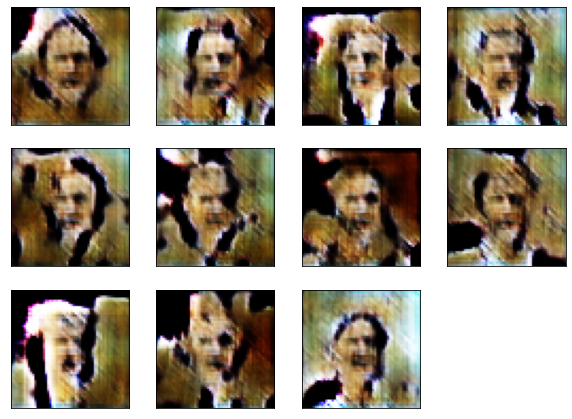

[Step 13000] D Loss: 0.1866; G Loss: 6.3074


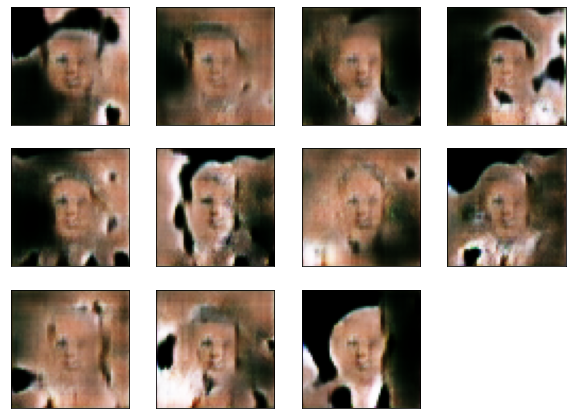

[Step 13200] D Loss: 0.0436; G Loss: 7.1994


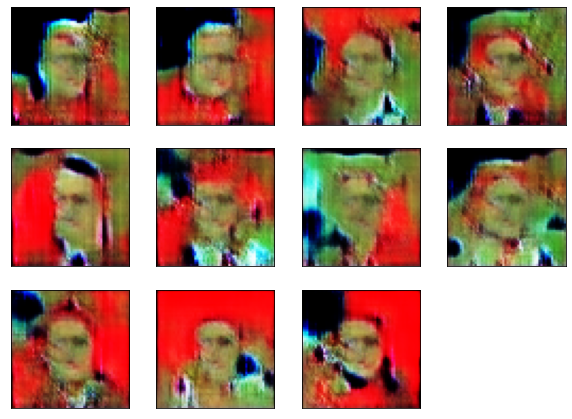

[Step 13400] D Loss: 0.3708; G Loss: 6.0416


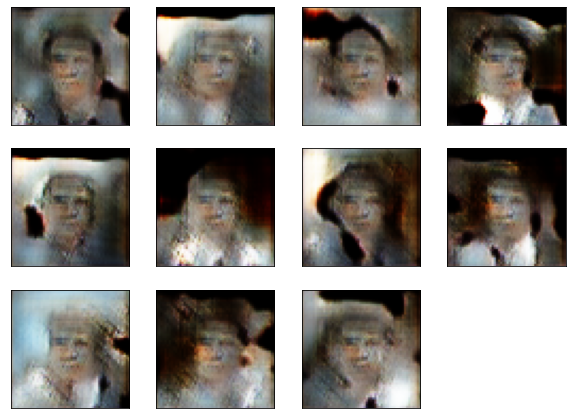

[Step 13600] D Loss: 0.1631; G Loss: 6.1684


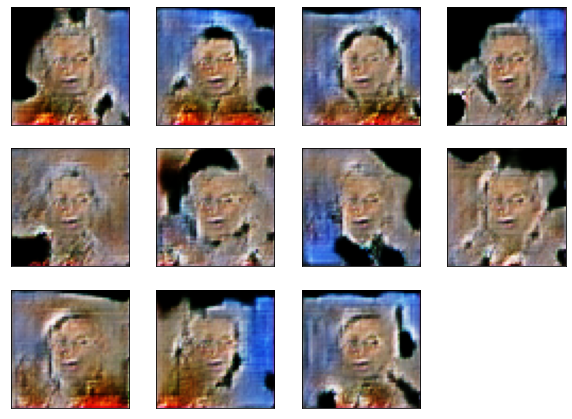

[Step 13800] D Loss: 0.2104; G Loss: 5.0633


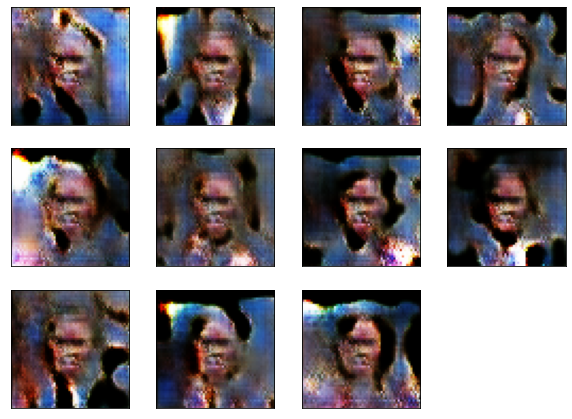

[Step 14000] D Loss: 0.3801; G Loss: 7.6357


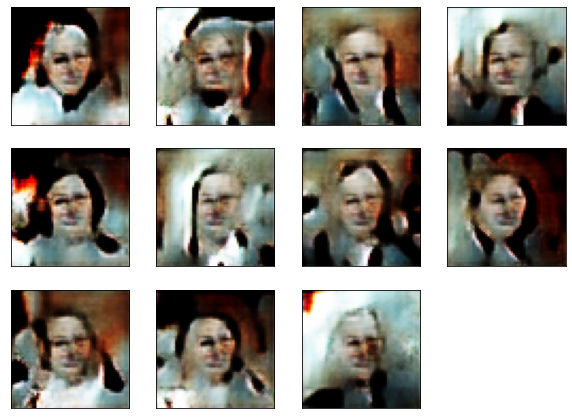

[Step 14200] D Loss: 0.0556; G Loss: 6.7381


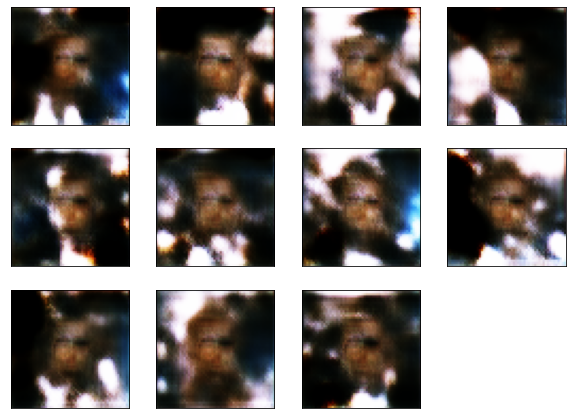

[Step 14400] D Loss: 0.2218; G Loss: 5.4100


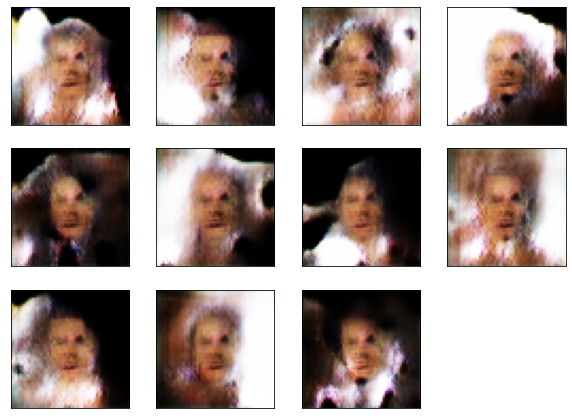

[Step 14600] D Loss: 0.1126; G Loss: 6.5928


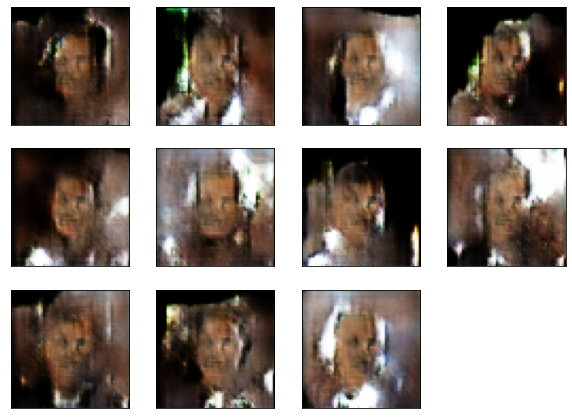

[Step 14800] D Loss: 0.1281; G Loss: 6.6516


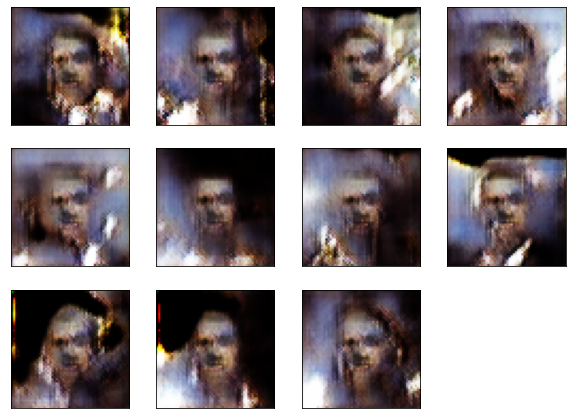

[Step 15000] D Loss: 0.4593; G Loss: 5.8174


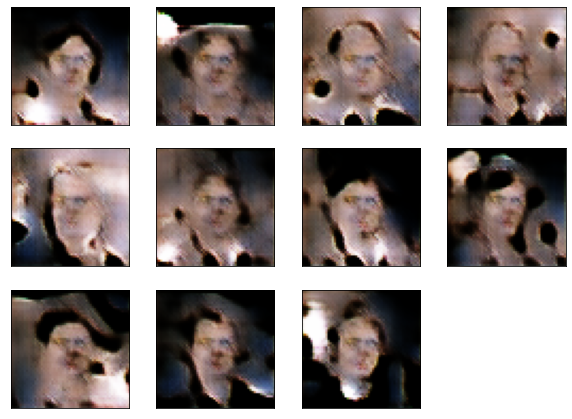

[Step 15200] D Loss: 0.4255; G Loss: 7.5985


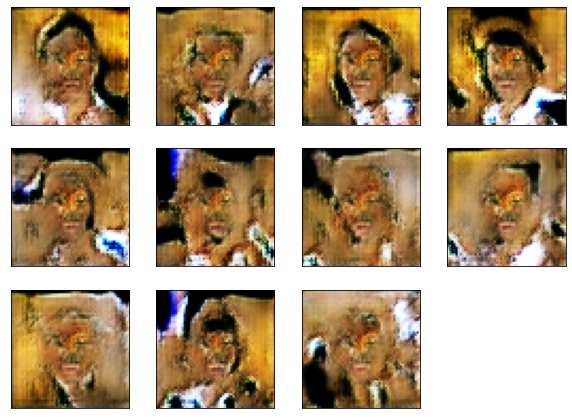

[Step 15400] D Loss: 0.4723; G Loss: 3.4884


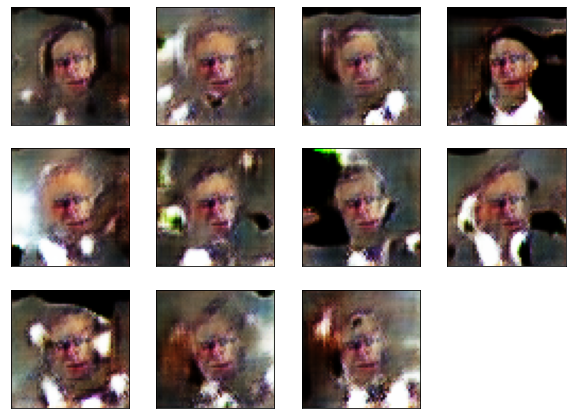

[Step 15600] D Loss: 0.2444; G Loss: 4.1709


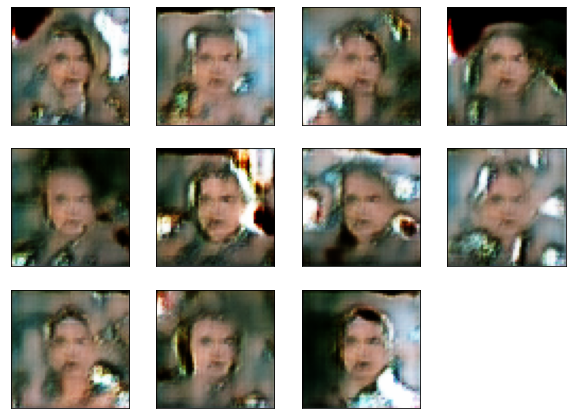

[Step 15800] D Loss: 0.3041; G Loss: 6.4755


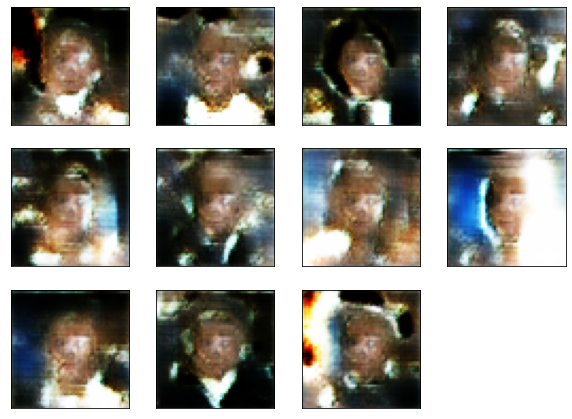

[Step 16000] D Loss: 0.1964; G Loss: 7.5247


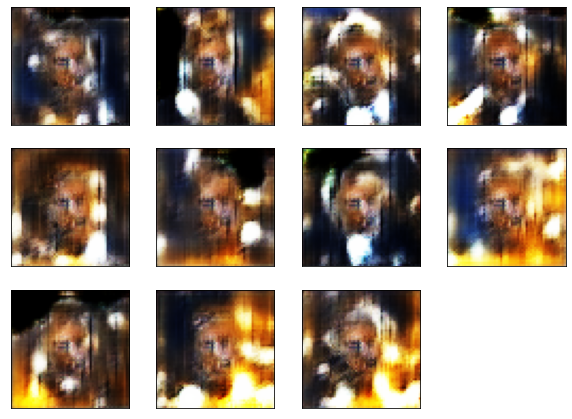

[Step 16200] D Loss: 0.6343; G Loss: 5.2933


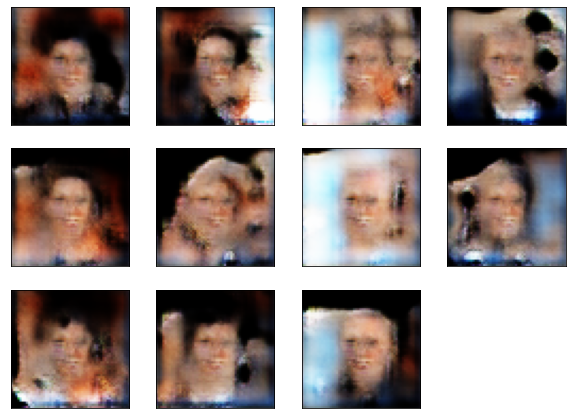

[Step 16400] D Loss: 0.1721; G Loss: 8.1356


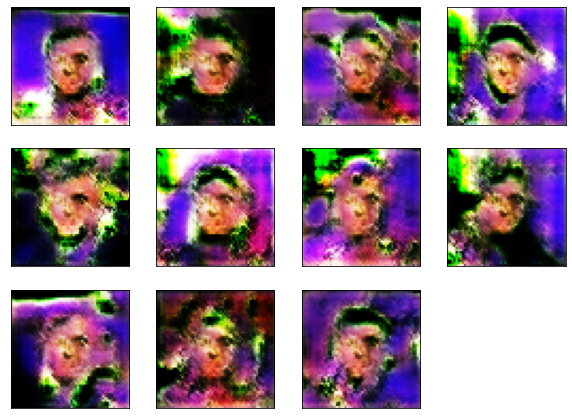

In [9]:
for step, true_images in enumerate(train_ds):
    
    # Train Discriminator
    
    noise = np.random.normal(0, 1, (HALF_BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    syntetic_images = generator.predict(noise)
    x_combined = np.concatenate((
        true_images, 
        syntetic_images))
    y_combined = np.concatenate((
        np.ones((HALF_BATCH_SIZE, 1), np.float32), 
        np.zeros((HALF_BATCH_SIZE, 1), np.float32)))
    
    with tf.GradientTape() as tape:
        logits = discriminator(x_combined, training=True)
        d_loss_value = sigmoid_cross_entropy(y_combined, logits)
    grads = tape.gradient(d_loss_value, discriminator.trainable_variables)
    optimizer.apply_gradients(zip(grads, discriminator.trainable_variables))
    
    # Train Generator
    
    noise = np.random.normal(0, 1, (BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    y_mislabled = np.ones((BATCH_SIZE, 1), np.float32)
    
    with tf.GradientTape() as tape:
        syntetic = generator(noise, training=True)
        logits = discriminator(syntetic, training=False)
        g_loss_value = sigmoid_cross_entropy(y_mislabled, logits)
    grads = tape.gradient(g_loss_value, generator.trainable_variables)
    optimizer.apply_gradients(zip(grads, generator.trainable_variables))
    
    # Check intermediate results
    
    if step % 200 == 0:
        print('[Step %2d] D Loss: %.4f; G Loss: %.4f' % (
            step, d_loss_value.numpy(), g_loss_value.numpy()))
        noise = np.random.normal( 0, 1, (11, INPUT_DIM)).astype(np.float32)
        syntetic_images = generator.predict(noise)
        plot_syntetic(syntetic_images)


## Тестирование свёрточного генератора

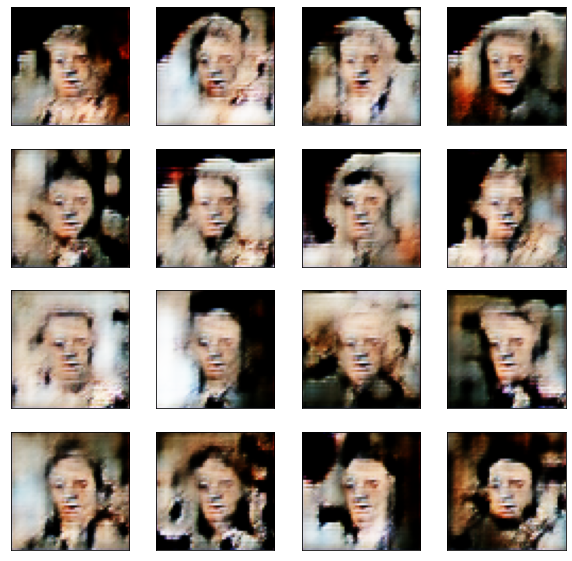

In [21]:
noise = np.random.normal(0, 1, (16, 300)).astype(np.float32)
syntetic_images = generator.predict(noise)
plot_syntetic(syntetic_images)

## Интерполяция в латентном пространстве

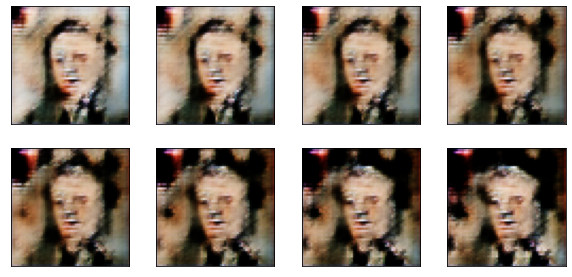

In [11]:
noise_1 = np.random.normal(0, 1, (INPUT_DIM)).astype(np.float32)
noise_2 = np.random.normal(0, 1, (INPUT_DIM)).astype(np.float32)
noise = np.linspace(noise_1, noise_2, 8)
syntetic_images = generator.predict(noise)
plot_syntetic(syntetic_images)